In [2]:
!pip install -Uqq fastai

In [3]:
from fastai.vision.all import *

In [57]:
from fastai.vision.widgets import *

In [28]:
search_images_ddg

<function fastbook.search_images_ddg>

In [19]:
#!pip install fastbook
from fastbook import *

In [21]:
urls = search_images_ddg('flowers', max_images=100)
len(urls),urls[0]

(100, 'https://www.hdwallpapers.in/download/3_pink_flowers-1440x900.jpg')

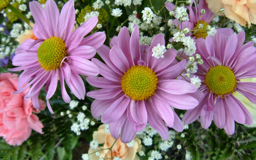

In [29]:
dest = 'images/flower.jpg'
download_url(urls[0], dest)
im = Image.open('images/flower.jpg')
im.thumbnail((256,256))
im

In [34]:
flower_color = 'white flower','yellow flower','red flower','pink flower'
path = Path('flowers')

In [38]:
if not path.exists():
    path.mkdir()
    for o in flower_color:
        dest = (path/o)
        dest.mkdir(exist_ok=True)
        results = search_images_ddg(o)
        download_images(dest = dest, urls = results)

In [39]:
fns = get_image_files(path)
fns

(#771) [Path('flowers/white flower/3e22c569-469b-4b3f-a88d-402ddb400770.jpg'),Path('flowers/white flower/57c7abea-91d0-4ef8-a708-36c47259dcd8.jpg'),Path('flowers/white flower/60fc07c0-449f-439a-be98-69b3deb5ad39.jpg'),Path('flowers/white flower/cc895875-95c8-4de5-8525-87f6de3f52e1.jpg'),Path('flowers/white flower/c3452595-f177-437e-a5e8-ac5066373298.jpg'),Path('flowers/white flower/f04dd7dc-1672-412e-9624-265635314c12.jpg'),Path('flowers/white flower/661a0fe5-76a3-4684-88f2-842dacc71da0.jpg'),Path('flowers/white flower/0bce6877-5d81-4c6b-bc26-a74e0f18d32e.jpg'),Path('flowers/white flower/00e68abc-a777-4a18-adf7-c34b162b9f9c.jpg'),Path('flowers/white flower/836985a1-3663-4326-8d53-87efcfff38b2.jpg')...]

In [40]:
failed = verify_images(fns)
failed

(#8) [Path('flowers/white flower/7d3c052e-6870-4289-984e-3ed25aa34f52.jpg'),Path('flowers/white flower/fe75c119-a15d-4ce9-9071-2099cb8dcc03.jpg'),Path('flowers/red flower/873adb14-b29e-4afa-b36b-ca4581109d71.jpg'),Path('flowers/red flower/7d7457ee-60d4-492d-88aa-c98755cd494b.jpg'),Path('flowers/yellow flower/fdc5881b-afd6-470d-9452-2758df3a1440.jpg'),Path('flowers/yellow flower/6c4f5e63-463c-4488-9c2a-51b66412e692.jpeg'),Path('flowers/pink flower/0d0ba0c9-b01d-49b3-b2bd-20dcb02a959e.jpg'),Path('flowers/pink flower/342148db-abef-4340-b012-6692273246a6.jpg')]

In [41]:
failed.map(Path.unlink);

In [42]:
flowers = DataBlock(
    blocks=(ImageBlock, CategoryBlock), 
    get_items=get_image_files, 
    splitter=RandomSplitter(valid_pct=0.2, seed=42),
    get_y=parent_label,
    item_tfms=Resize(128))

In [43]:
dls = flowers.dataloaders(path)

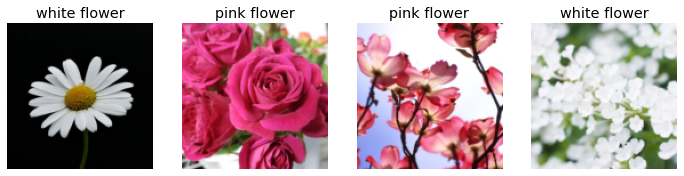

In [44]:
dls.valid.show_batch(max_n=4, nrows=1)

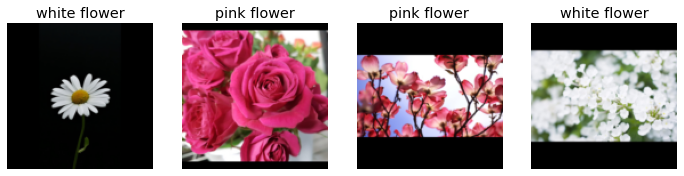

In [46]:
flowers = flowers.new(item_tfms=Resize(128, ResizeMethod.Pad, pad_mode='zeros'))
dls = flowers.dataloaders(path)
dls.valid.show_batch(max_n=4, nrows=1)

In [47]:
flowers = flowers.new(
    item_tfms=RandomResizedCrop(224, min_scale=0.5),
    batch_tfms=aug_transforms())
dls = flowers.dataloaders(path)

In [48]:
learn = vision_learner(dls, resnet18, metrics=error_rate)
learn.fine_tune(4)

/usr/local/lib/python3.7/dist-packages/torchvision/models/_utils.py:136: UserWarning: Using 'weights' as positional parameter(s) is deprecated since 0.13 and will be removed in 0.15. Please use keyword parameter(s) instead.
  f"Using {sequence_to_str(tuple(keyword_only_kwargs.keys()), separate_last='and ')} as positional "
/usr/local/lib/python3.7/dist-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and will be removed in 0.15. The current behavior is equivalent to passing `weights=ResNet18_Weights.IMAGENET1K_V1`. You can also use `weights=ResNet18_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)
Downloading: "https://download.pytorch.org/models/resnet18-f37072fd.pth" to /root/.cache/torch/hub/checkpoints/resnet18-f37072fd.pth


  0%|          | 0.00/44.7M [00:00<?, ?B/s]

epoch,train_loss,valid_loss,error_rate,time
0,1.934936,0.540845,0.210526,02:40


epoch,train_loss,valid_loss,error_rate,time
0,0.724525,0.298965,0.105263,03:31
1,0.510338,0.223494,0.078947,03:28
2,0.394187,0.189577,0.052632,03:26
3,0.321651,0.178831,0.046053,03:35


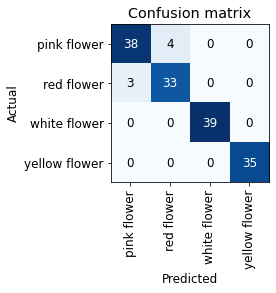

In [49]:
interp = ClassificationInterpretation.from_learner(learn)
interp.plot_confusion_matrix()

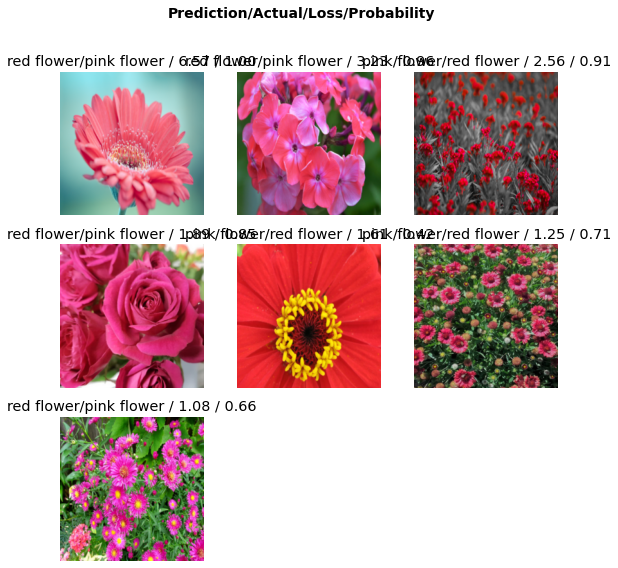

In [55]:
interp.plot_top_losses(7,nrows = 3)

In [58]:
cleaner = ImageClassifierCleaner(learn)
cleaner

In [59]:
for idx in cleaner.delete(): cleaner.fns[idx].unlink()
for idx,cat in cleaner.change(): shutil.move(str(cleaner.fns[idx]), path/cat)

In [60]:
learn.export()

In [61]:
path = Path()
path.ls(file_exts='.pkl')

(#1) [Path('export.pkl')]

In [62]:
learn_inf = load_learner(path/'export.pkl')

In [65]:
learn_inf.predict('images/flower.jpg')

('pink flower', TensorBase(0), TensorBase([0.8906, 0.0106, 0.0770, 0.0218]))

In [66]:
learn_inf.dls.vocab

['pink flower', 'red flower', 'white flower', 'yellow flower']

In [67]:
btn_upload = widgets.FileUpload()
btn_upload

FileUpload(value={}, description='Upload')

In [68]:
btn_upload = SimpleNamespace(data = ['images/flower.jpg'])

In [71]:
img = PILImage.create(btn_upload.data[-1])

In [72]:
out_pl = widgets.Output()
out_pl.clear_output()
with out_pl: display(img.to_thumb(128,128))
out_pl

Output()

In [73]:
pred,pred_idx,probs = learn_inf.predict(img)

In [74]:
lbl_pred = widgets.Label()
lbl_pred.value = f'Prediction: {pred}; Probability: {probs[pred_idx]:.04f}'
lbl_pred

Label(value='Prediction: pink flower; Probability: 0.8906')

In [75]:
btn_run = widgets.Button(description='Classify')
btn_run

Button(description='Classify', style=ButtonStyle())

In [76]:
def on_click_classify(change):
    img = PILImage.create(btn_upload.data[-1])
    out_pl.clear_output()
    with out_pl: display(img.to_thumb(128,128))
    pred,pred_idx,probs = learn_inf.predict(img)
    lbl_pred.value = f'Prediction: {pred}; Probability: {probs[pred_idx]:.04f}'

btn_run.on_click(on_click_classify)

In [78]:
btn_upload = widgets.FileUpload()

In [79]:
VBox([widgets.Label('Upload your flower!'), 
      btn_upload, btn_run, out_pl, lbl_pred])